# University Hack 2020, reto minsait Land Classification.
## Entrega final del equipo Astralaria de la Universidad Politécnica de Valencia, formado por Asier Serrano Aramburu y Mario Campos Mocholí.


## Índice.
### 1. Imports.
### 2. Obtención de los datos preprocesados.
### 3. Visualizaciones.
### 4. Feature Engineering.
### 5. Modelo XGBoostClassifier + RandomForest.
### 6. Resultado final.

## 1. Imports.

In [5]:
 # coding=utf-8
#Librerías.
import numpy as np

#Métodos desarrollados por Astralaria.
from Astralarialib.datasets_get import get_mod_data_original, get_modelar_data, get_estimar_data, get_modelar_data_ids, getX, getY
from Astralarialib.feature_engineering import coordinates_fe
from Astralarialib.visualization import pca_general, tsne, violin_plot, violin_plot_kdtree, hist_decomposition
from Astralarialib.not_random_test_generator import random_undersample_residential

## 2. Obtención de los datos.

In [6]:
#Modelar set original sin IDs.
modelar_or_df = get_mod_data_original()
#Modelar set preprocesado sin IDs.
modelar_df_st = get_modelar_data()
#Modelar set preprocesado con IDs.
modelar_id_df = get_modelar_data_ids()


#Datasets empleados en el modelo
modelar_df = random_undersample_residential(modelar_id_df)
X_modelar = getX(modelar_df)
X_estimar = get_estimar_data()
Y_modelar = getY(modelar_df)

0            1             2           3           4  \
29574   F0F49E383C5EE74E  165735392.0  0.000000e+00  343.996613  567.010620   
7141    7851C0BCAE22DE13  165286480.0  2.146913e-06  464.999939  610.000244   
98807   B3856383B2A2EDE0  165750368.0  0.000000e+00  343.996613  567.010620   
101737  B71F9533A0CD5085  165642992.0  0.000000e+00  364.999878  548.002014   
63683   1DB68338CC50078A  165500448.0  0.000000e+00  466.700043  601.001038   
...                  ...          ...           ...         ...         ...   
8825    EE28D1A701B19B29  165658336.0  0.000000e+00  364.999878  548.002014   
57062   9818B481411BBBB1  165323632.0  0.000000e+00  586.699951  721.998169   
47792   B4E8462CCE1495DA  165444000.0  5.879611e-05  443.899017  627.999084   
98689   B98419A6495E0D01  165641040.0  2.926348e-06  619.999084  779.000366   
3322    D2D4C4D0E911054C  165522256.0  7.752092e-11  451.006500  635.998413   

                 5            6            7            8            9  ..

## 3. Visualizaciones.

### Histograma que ilustra el desbalanceamiento de los datos.

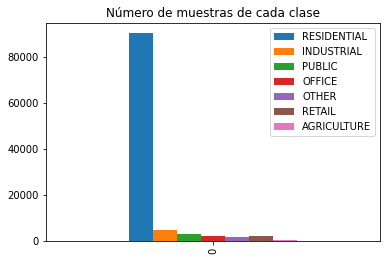

In [10]:
hist_decomposition()

### PCA 2D y 3D con datos originales.

[9.99945152e-01 5.49684605e-05]


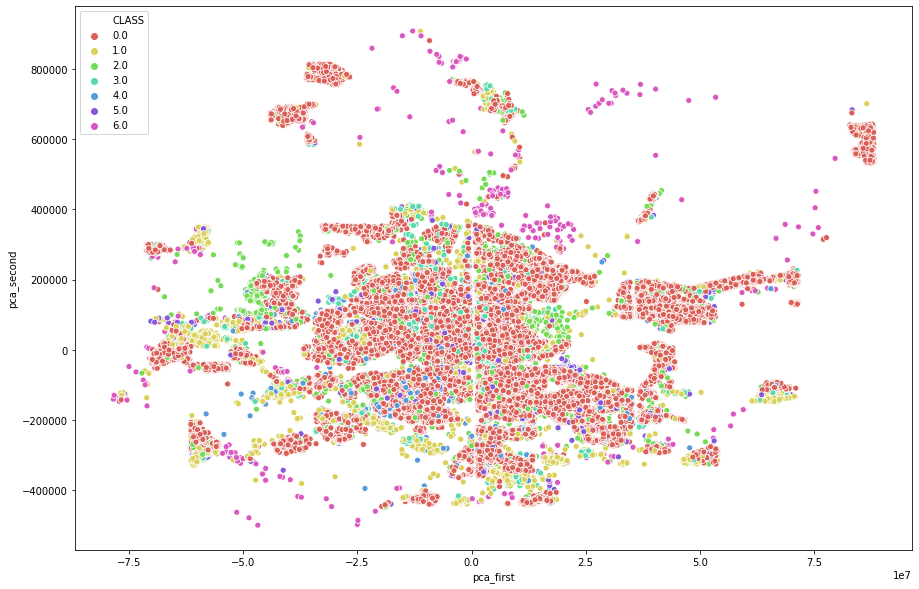

[9.99945288e-01 5.49684831e-05 1.62059689e-08]


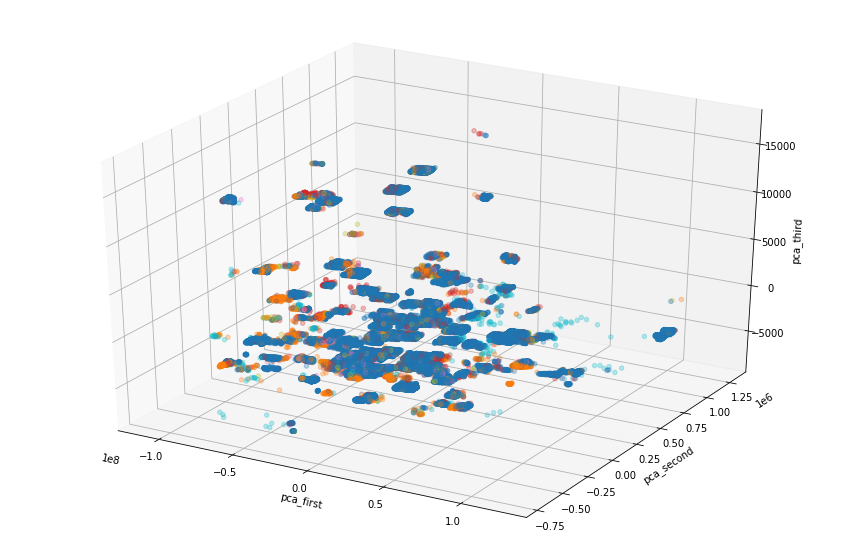

In [4]:
pca_general(getX(modelar_or_df), getY(modelar_or_df))

### t-SNE con perplejidad 50.

In [ ]:
tsne(getX(modelar_or_df), getY(modelar_or_df), [50], 2)

### Violin plots de cada feature.

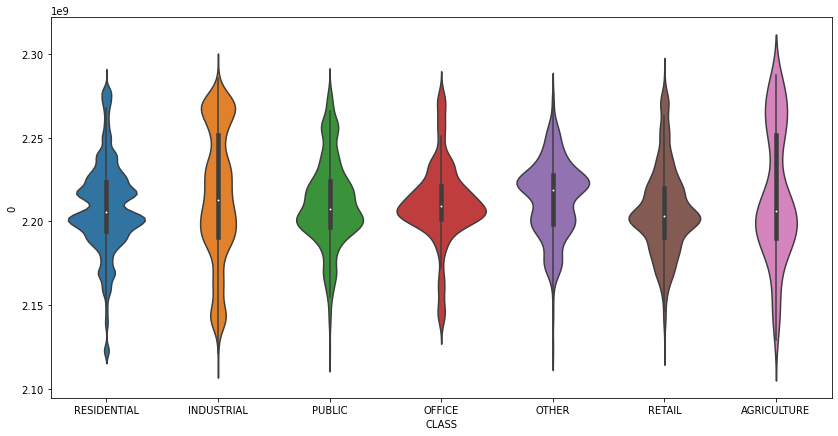

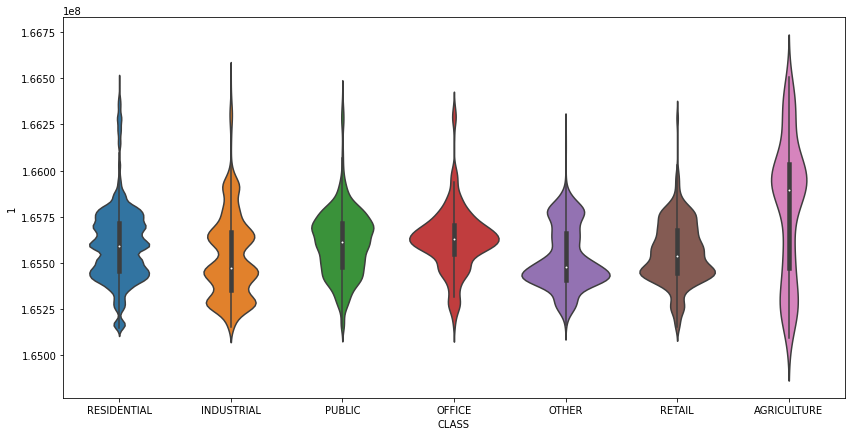

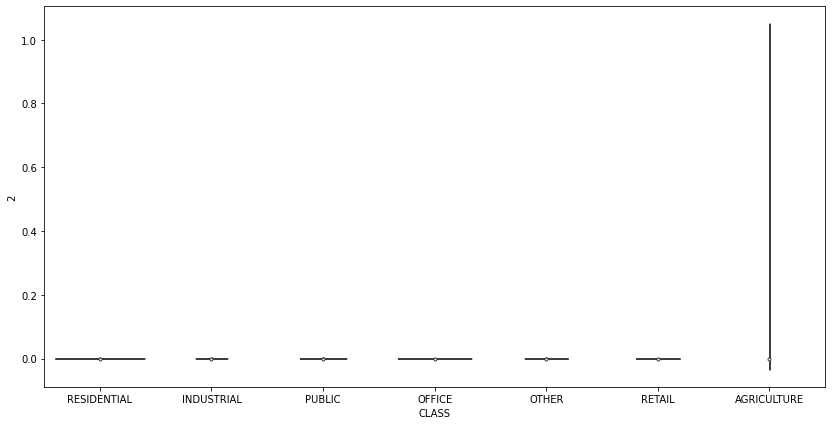

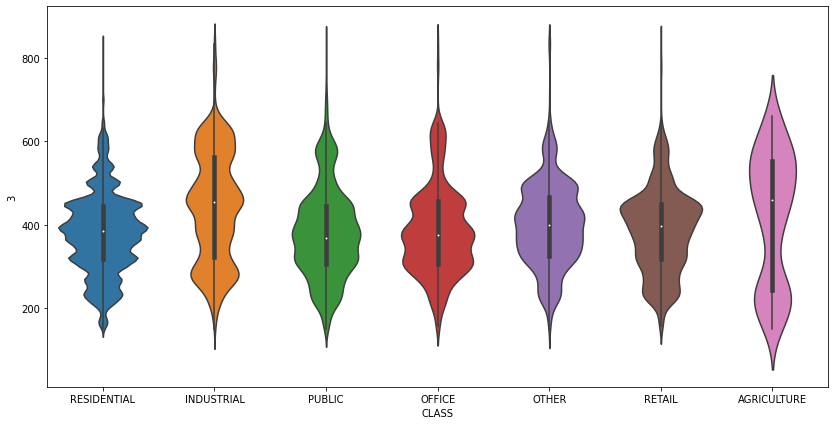

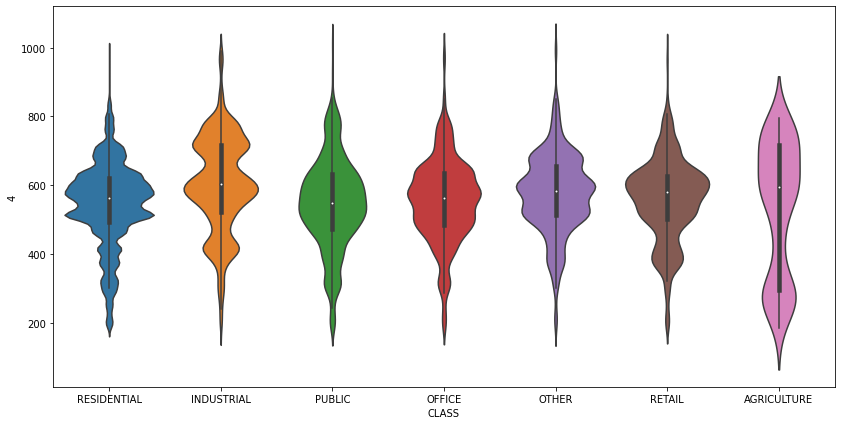

...

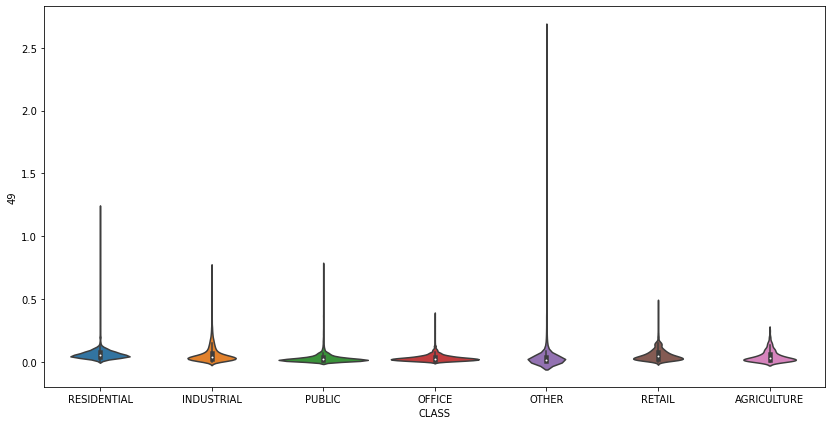

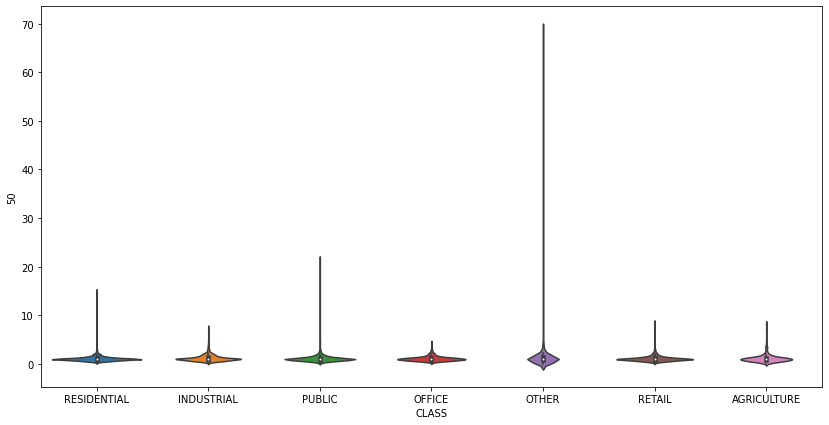

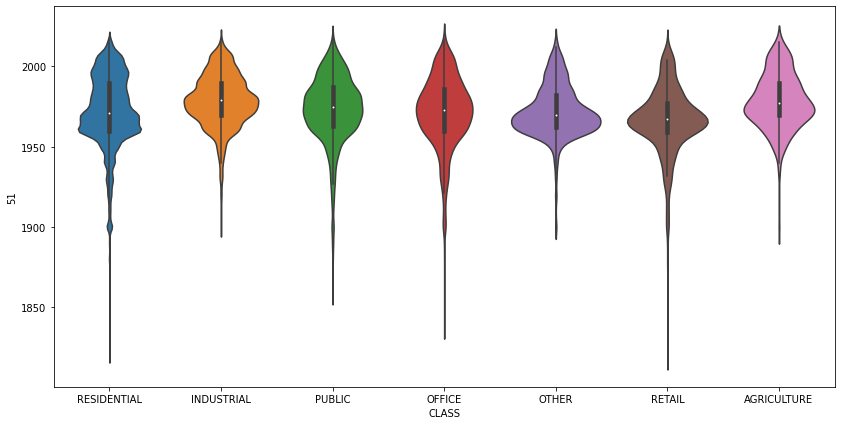

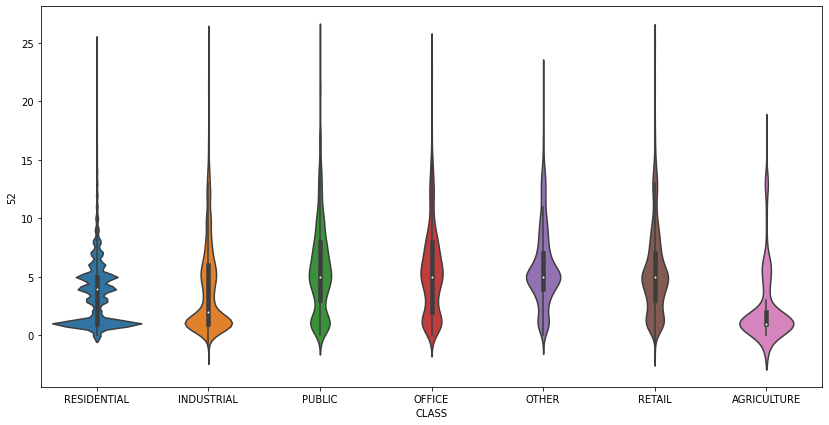

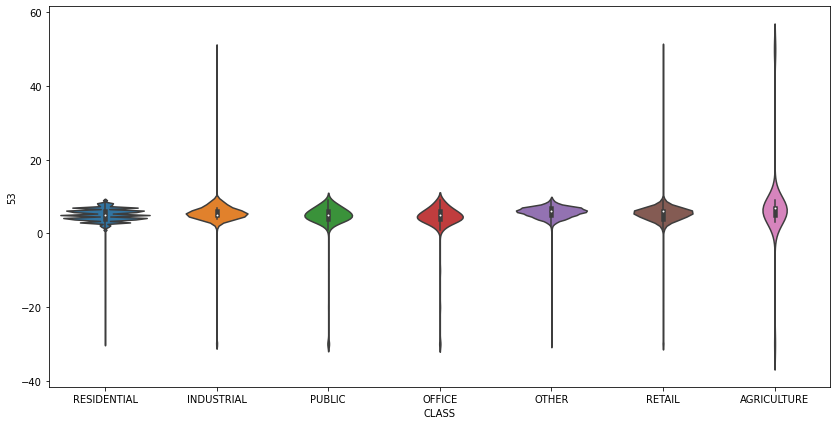

In [7]:
#Realizamos un violin plot de cada feature por clase,
#para ver como se superponen entre sí.
violin_plot()

## 4. Feature Engineering

In [8]:
#Obtenemos los datasets estimar y modelar
#con las variables de los k-vecinos más próximos.
X_modelar, X_estimar, est_IDS = coordinates_fe(X_modelar, Y_modelar, X_estimar)

#Convertimos los pandas dataframes a numpy arrays.
Y_modelar = Y_modelar.values

Y_modelar = Y_modelar[1:, :]
X_estimar = X_estimar[1:, :]
X_modelar = X_modelar[1:, :]

Nuevas 7 features dataset modelar, primeras 20.
    coords_RESIDENTIAL  coords_INDUSTRIAL  coords_PUBLIC  coords_OFFICE  \
0             2.000000           0.000000       0.000000       0.000000   
1             1.000000           1.000000       0.000000       0.000000   
2             0.000000           0.000000       1.000000       0.000000   
3             0.000000           3.000000       0.000000       0.000000   
4             0.000000           0.000000       1.000000       0.000000   
5             1.483643           0.136664       0.212338       0.044641   
6             1.000000           2.000000       0.000000       0.000000   
7             3.000000           0.000000       0.000000       0.000000   
8             0.000000           1.000000       0.000000       1.000000   
9             2.082273           0.054921       0.247647       0.014271   
10            0.000184           1.953781       0.000832       1.030777   
11            0.906159           0.040709       1.02

## 5.  Modelo XGBoostClassifier + RandomForest.

In [ ]:
# Variable que contendrá las muestras separadas por clase
data_per_class = []

# Añadimos una lista vacía por clase
for _ in range(7):         
    data_per_class.append([])

# Añadimos a la lista de cada clase las muestras de esta
for i in range(len(X_modelar)):
    data_per_class[int(Y_modelar[i])].append(X_modelar[i, 1:].tolist() + Y_modelar[i].tolist())


# Variable que contendrá los datos procesados
data_proc = []


# Variable que contendra las predicciones globales de cada muestra
predictions = {}

# Número de iteraciones total por módelo
iterations = 2

# Si True, muestra información de cada modelo local tras entrenarlo
debug_mode = True

# Si True, guarda los mejores modelos para poder replicar el clasificador
persistent_mode = False

# Variable en el rango (0.0 - 1.0) que indica el procentaje de muestras de validación
test_avg = 0.15

# Variable en el rango (0.0 - 1.0) que indica el procentaje de mejores modelos a utilizar
best_model_avg = 0.4

# Variables que miden las métricas globlales del ENTRENAMIENTO
accuracy_avg = 0
precision_avg = 0
recall_avg = 0
f1_avg = 0

# Lista que contendra diccionarios con las metricas de cada modelo, predicciones y conjunto de datos utilizados
concensus = []

# Los diccionarios anteriores seguiran el siguiente formato:
'''
model_info = {
    "accuracy":
    "precision":
    "recall":
    "f1":
    "predictions":
    "data": {
            'X_train': X_train, 
            'X_test': X_test, 
            'y_train': y_train, 
            'y_test': y_test,
        },
    "model": <- Solo si 'persistent_mode' es True
}
'''

for ite in range(iterations):
    data_proc = []
    # Muestras de la clase RESIDENTIAL
    random.shuffle(data_per_class[0])
    data_proc += data_per_class[0][:6000]

    # Muestras de las otras clases
    for i in range(6):
        data_proc += data_per_class[i + 1]
        
    # Volvemos a convertir los datos una vez procesados a una matriz
    data_proc = np.array(data_proc)

    # Obtenemos una separación del conjunto de train y test equilibrado (respecto a porcentaje de cada clase)
    pos = len(data_proc[0]) - 1
    X, Y = (data_proc[:, :pos], data_proc[:, pos])

    sss = StratifiedShuffleSplit(n_splits = 1, test_size = test_avg)

    for train_index, test_index in sss.split(X, Y):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = Y[train_index], Y[test_index]


    # Mostramos el porcentaje de entrenamiento
    print('Entrenamiento completo al {}%'.format(ite/iterations * 100))
    
    # Modelo XGB
    model = xgb.XGBClassifier(
        # General parameters
        # Tree Booster parameters
        eta = 0.15,
        max_depth = 10,
        n_estimators = 240,
        tree_method = 'exact',
        # Learning task parameters
        objective = 'multi:softmax',
        num_class =  7,
        eval_metric = 'merror',
    )
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Métricas del modelo entrenado
    if debug_mode:
        print('XGBoost ({})'.format(ite))
        print('Accuracy: {}'.format(accuracy_score(y_test, y_pred)))
        print('Precision (macro): {}'.format(precision_score(y_test, y_pred, average = 'macro')))
        print('Recall (macro): {}'.format(recall_score(y_test, y_pred, average = 'macro')))
        print('F1 (macro): {}\n'.format(f1_score(y_test, y_pred, average = 'macro')))
    
    # Actualización de las métricas de ENTRENAMIENTO
    accuracy_avg += accuracy_score(y_test, y_pred)
    precision_avg += precision_score(y_test, y_pred, average = 'macro')
    recall_avg += recall_score(y_test, y_pred, average = 'macro')
    f1_avg += f1_score(y_test, y_pred, average = 'macro')

    # Diccionario con la información del modelo
    model_info = {
        "accuracy": accuracy_score(y_test, y_pred),
        "precision": precision_score(y_test, y_pred, average = 'macro'),
        "recall": recall_score(y_test, y_pred, average = 'macro'),
        "f1": f1_score(y_test, y_pred, average = 'macro'),
        "predictions": model.predict(X_estimar[:, 1:].astype('float32')),
        "data": {
            'X_train': X_train, 
            'X_test': X_test, 
            'y_train': y_train, 
            'y_test': y_test,
        },
    }
    if persistent_mode:
        model_info['model'] = model
    concensus.append(model_info)

        
    # Modelo RandomForest
    model = RandomForestClassifier(
        criterion = 'entropy',
        n_jobs = -1,
        max_features = None,
        n_estimators = 400,
        max_depth = 50,
        min_samples_split = 3,
        min_samples_leaf = 1,
    )
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    # Métricas del modelo entrenado
    if debug_mode:
        print('RF ({})'.format(ite))
        print('Accuracy: {}'.format(accuracy_score(y_test, y_pred)))
        print('Precision (macro): {}'.format(precision_score(y_test, y_pred, average = 'macro')))
        print('Recall (macro): {}'.format(recall_score(y_test, y_pred, average = 'macro')))
        print('F1 (macro): {}\n'.format(f1_score(y_test, y_pred, average = 'macro')))
    
    # Actualización de las métricas de ENTRENAMIENTO
    accuracy_avg += accuracy_score(y_test, y_pred)
    precision_avg += precision_score(y_test, y_pred, average = 'macro')
    recall_avg += recall_score(y_test, y_pred, average = 'macro')
    f1_avg += f1_score(y_test, y_pred, average = 'macro')

    # Diccionario con la información del modelo
    model_info = {
        "accuracy": accuracy_score(y_test, y_pred),
        "precision": precision_score(y_test, y_pred, average = 'macro'),
        "recall": recall_score(y_test, y_pred, average = 'macro'),
        "f1": f1_score(y_test, y_pred, average = 'macro'),
        "predictions": model.predict(X_estimar[:, 1:].astype('float32')),
        "data": {
            'X_train': X_train, 
            'X_test': X_test, 
            'y_train': y_train, 
            'y_test': y_test,
        },
    }
    if persistent_mode:
        model_info['model'] = model
    concensus.append(model_info)


print('\nEntrenamiento completo\n')
print('MÉTRICAS DEL ENTRENAMIENTO (global)')
print('Accuracy: {}'.format(accuracy_avg / (iterations * 2)))
print('Precision (macro): {}'.format(precision_avg / (iterations * 2)))
print('Recall (macro): {}'.format(recall_avg / (iterations * 2)))
print('F1(macro): {}'.format(f1_avg / (iterations * 2)))

# 1. Ordenamos 'concensous' según una métrica
concensus = sorted(concensus, key = lambda i: i['f1'], reverse = True)

# 2. Obtenemos los 'x' mejores modelos
n = int(iterations * 2 * best_model_avg)

# 3. Calculamos la métrica general para los 'x' modelos y predecimos
accuracy_avg = 0
precision_avg = 0
recall_avg = 0
f1_avg = 0

for i in range(n):
    # Métricas
    accuracy_avg += concensus[i]['accuracy']
    precision_avg += concensus[i]['precision']
    recall_avg += concensus[i]['recall']
    f1_avg += concensus[i]['f1']

    # Predicciones
    predictions_aux = model.predict(X_estimar[:, 1:].astype('float32'))
    for i in range(len(X_estimar)):
        if (X_estimar[i, 0] not in predictions):
            predictions[X_estimar[i, 0]] = [int(predictions_aux[i])]
        else:
            predictions[X_estimar[i, 0]].append(int(predictions_aux[i])) 

print('\nMÉTRICAS DEL MODELO (concenso)')
print('Accuracy: {}'.format(accuracy_avg / n))
print('Precision (macro): {}'.format(precision_avg / n))
print('Recall (macro): {}'.format(recall_avg / n))
print('F1 (macro): {}'.format(f1_avg / n))

# 4. Guardamos la partición que mejor resultado ha dado
# TODO: concensus[0]['data'] -> fichero csv
np.savetxt(r'Resultados/Res_FE-FINAL_(X_train).csv', concensus[0]['data']['X_train'], delimiter = '|')
np.savetxt(r'Resultados/Res_FE-FINAL_(X_test).csv', concensus[0]['data']['X_test'], delimiter = '|')
np.savetxt(r'Resultados/Res_FE-FINAL_(y_train).csv', concensus[0]['data']['y_train'], delimiter = '|')
np.savetxt(r'Resultados/Res_FE-FINAL_(y_test).csv', concensus[0]['data']['y_test'], delimiter = '|')

# Diccionario para decodificar el nombre de las clases
categorical_decoder_class = {0: 'RESIDENTIAL',
    1: 'INDUSTRIAL',
    2: 'PUBLIC',
    3: 'OFFICE',
    4: 'OTHER',
    5: 'RETAIL',
    6: 'AGRICULTURE'}

def most_frequent(lst): 
    return max(set(lst), key = lst.count) 

## 6. Resultado final.

In [ ]:
with open(r'Resultados/Res_FE-FINAL', 'w') as write_file:
    write_file.write('ID|CLASE\n')
    for sample in X_estimar:
        write_file.write('{}|{}\n'.format(sample[0], categorical_decoder_class[most_frequent(predictions[sample[0]])]))